In [ ]:
import os # allow changing, and navigating files and folders, 
import sys
import re # module to use regular expressions, 
import glob # lists names in folders that match Unix shell patterns
import random # functions that use and generate random numbers

import cv2
import numpy as np # support for multi-dimensional arrays and matrices
import pandas as pd # library for data manipulation and analysis
import seaborn as sns # advance plots, for statistics, 
import matplotlib as mpl # to get some basif functions, heping with plot mnaking 
import tensorflow_hub as hub

import tensorflow as tf # tf.__version__ 
import tensorflow.keras as keras 
import matplotlib.pyplot as plt # for making plots, 
import scipy.stats as stats  # library for statistics and technical programming, 
import scipy.cluster.hierarchy as sch

from tensorflow.keras.preprocessing.image import ImageDataGenerator
from PIL import Image, ImageDraw
from IPython.display import display
from tensorflow.keras import backend as K # used for housekeeping of tf models,
from sklearn.metrics import accuracy_score
# ...
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# SwissRoad Dataset Composition

In [6]:
# Load data,
os.chdir(PATH)

# .. fing any logfile created while saving img files, 
logfiles = []
for file in glob.glob(f"{''.join([module_names[0],'_',dataset_name])}*_logfile.csv"):
            logfiles.append(file)

# .. load batch labels,  
_, batch_labels = load_encoded_imgbatch_using_logfile( 
    logfile_name=logfiles[0], 
    load_datasetnames=subset_names)

# .. load raw imgages, 
raw_img_batch = load_raw_img_batch(
    load_datasetnames=subset_names, 
    path=PATH, 
    image_size=(500,500), verbose=False)

Found 840 images belonging to 6 classes.
Found 417 images belonging to 6 classes.


### - 1 - Pie Plot with numbers and pecentages of images with each class 

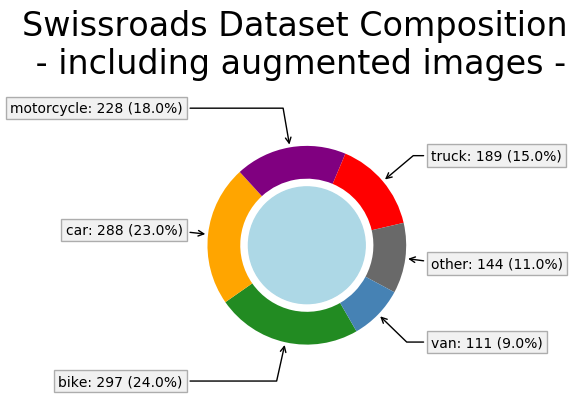

In [7]:
# Pie chart with swissroad dataset composition
annotated_pie_chart_with_class_and_group(
    title="Swissroads Dataset Composition \n - including augmented images - ",
    classnames=batch_labels.classname.values.tolist(), 
    class_colors=class_colors, 
    subplots_adjust_top=0.8,
    title_ha="center",
    mid_pie_circle_color="lightblue",
    legend=False # because each class is annotated, 
)

### - 2 - Plot image Examples from each class

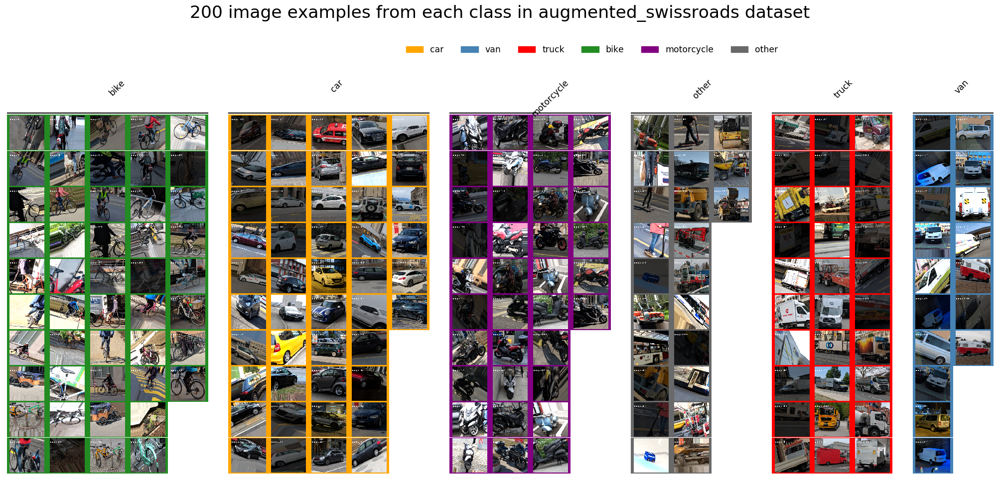

In [8]:
# select images, 
n = 200 # imega number selected
plot_img_examples(
    title=f"{n} image examples from each class in {dataset_name} dataset",
    selected_img_batch=raw_img_batch[img_idx], 
    img_groupname=batch_labels.classname.loc[img_idx].values.tolist(), 
    img_color = pd.Series(batch_labels.classname.values.tolist()).map(class_colors).loc[img_idx].values.tolist(),
    img_name = [" ".join(["image",str(x)]) for x in list(img_idx)], 
)                  

# Compare tfhub Modules used to extract features from images,

Found 840 images belonging to 6 classes.
Found 417 images belonging to 6 classes.


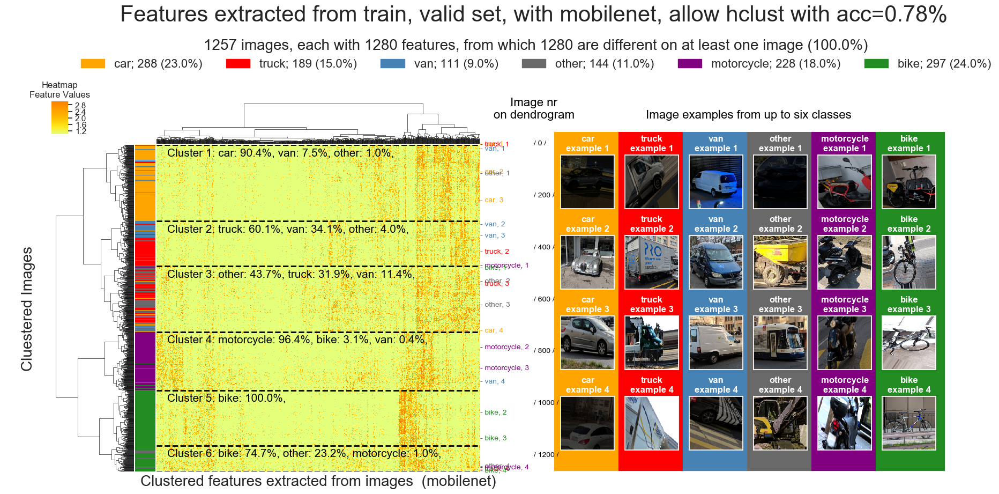

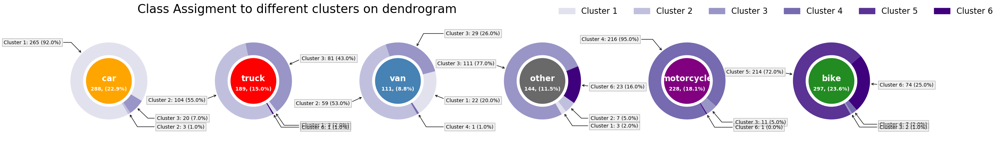

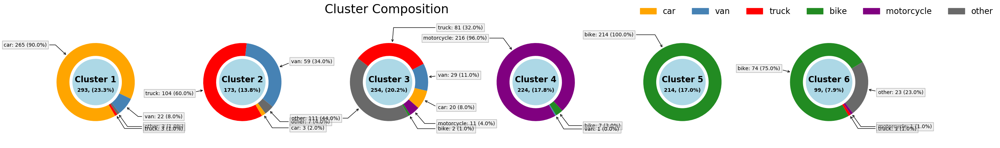

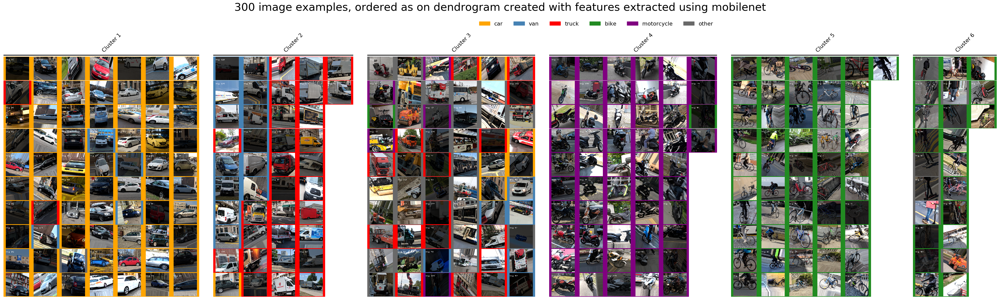

Found 840 images belonging to 6 classes.
Found 417 images belonging to 6 classes.


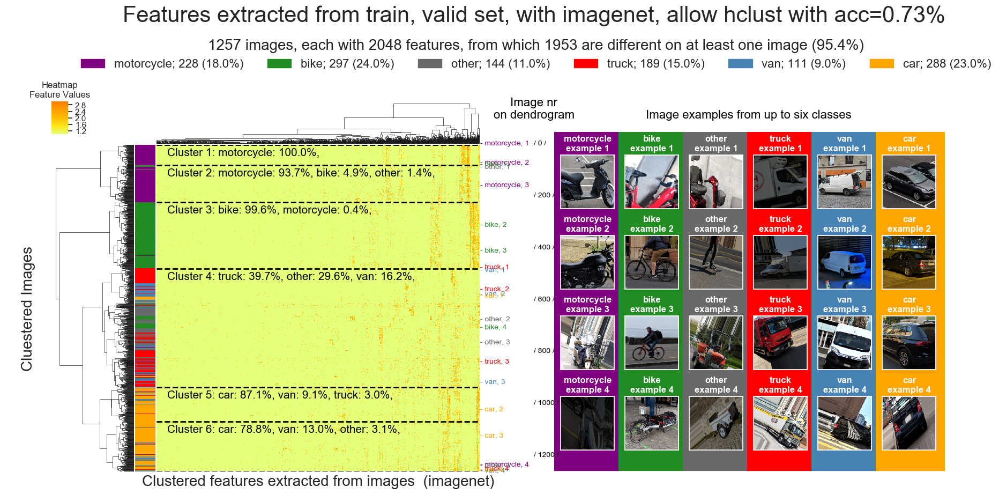

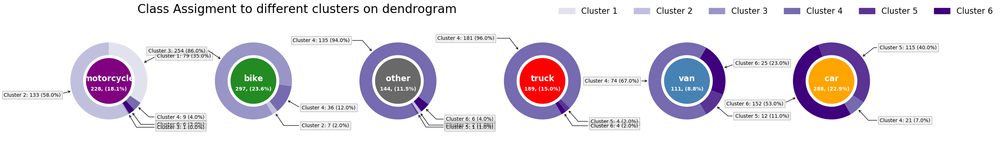

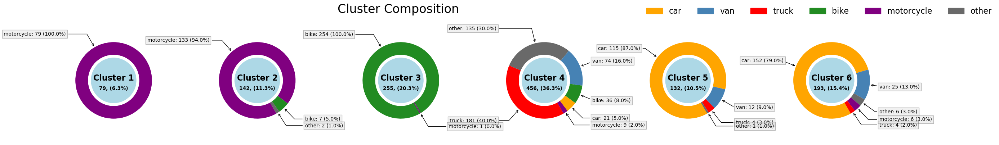

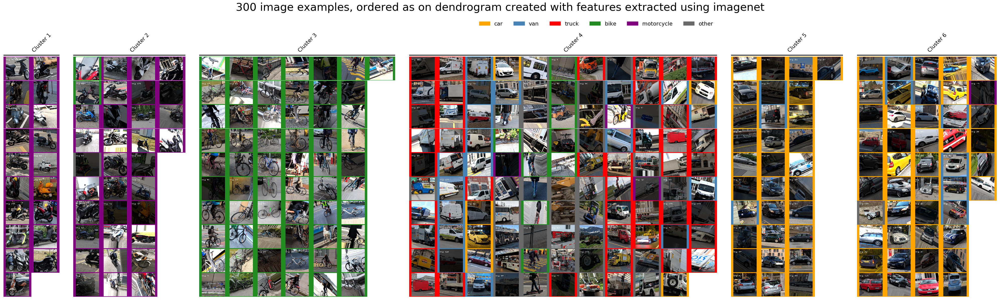

Found 840 images belonging to 6 classes.
Found 417 images belonging to 6 classes.


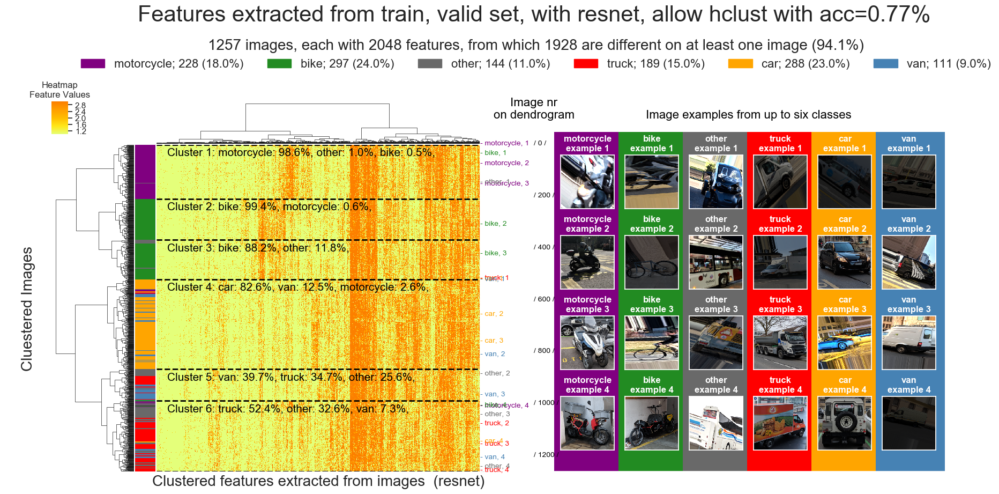

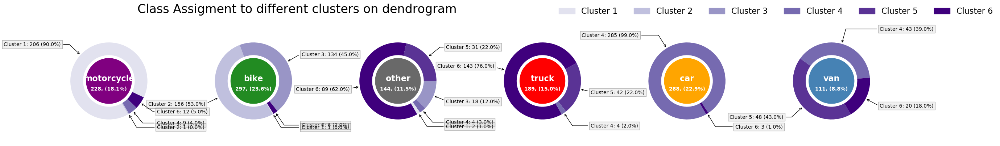

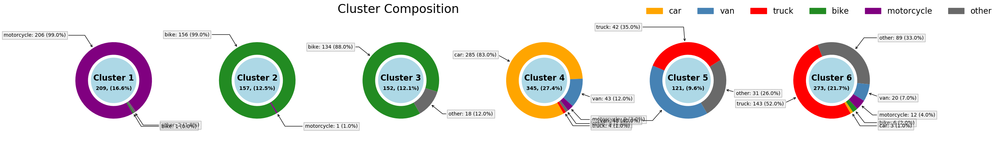

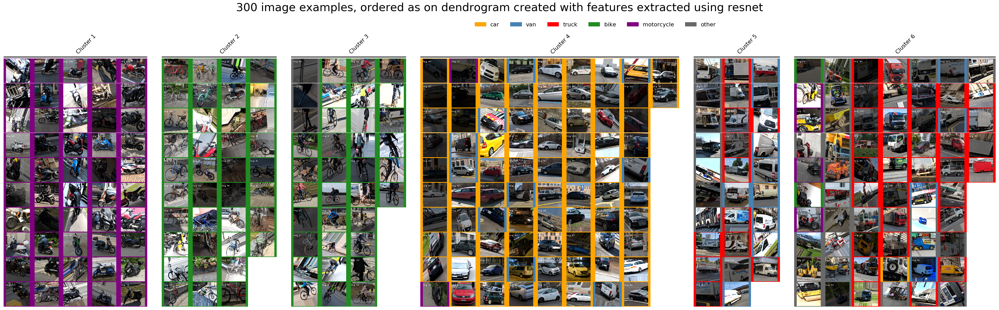

Found 840 images belonging to 6 classes.
Found 417 images belonging to 6 classes.


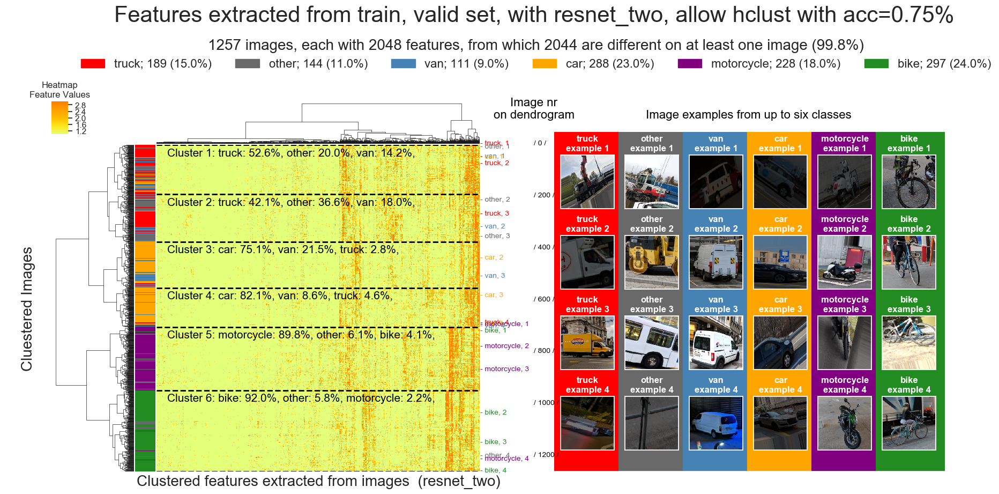

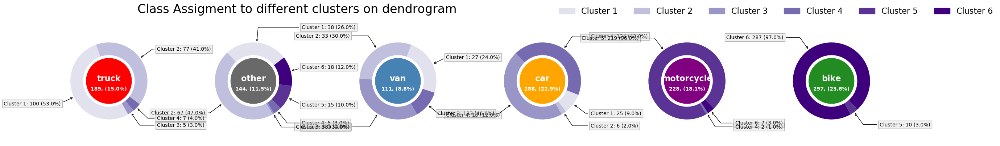

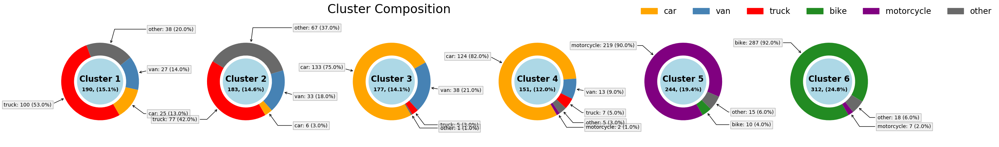

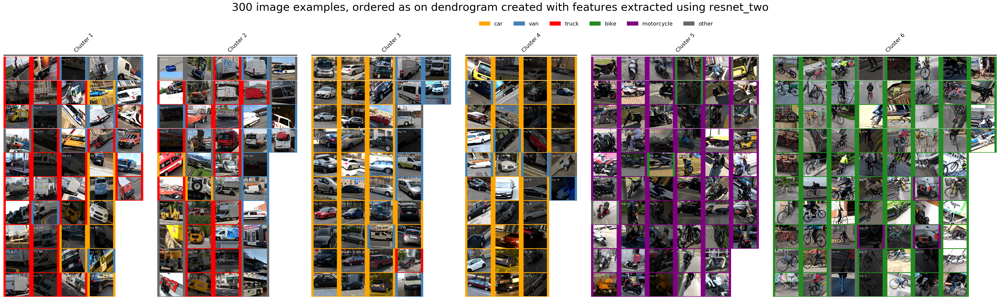

In [9]:
# Plot Image Examples from each cluster,  
n = 300
plot_img_examples_from_dendrogram(
        number_of_img_examples = n,
        raw_img_batch = raw_img_batch,
        data_for_plot = clustering_results[module_name],
        plot_title = f"{n} image examples, ordered as on dendrogram created with features extracted using {module_name}",
        max_img_per_col=10,
        figsize_scaling=1.5
)

# Analysis of extracted features from images using PCA

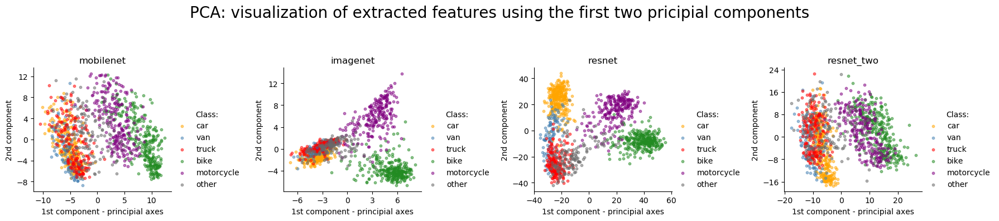

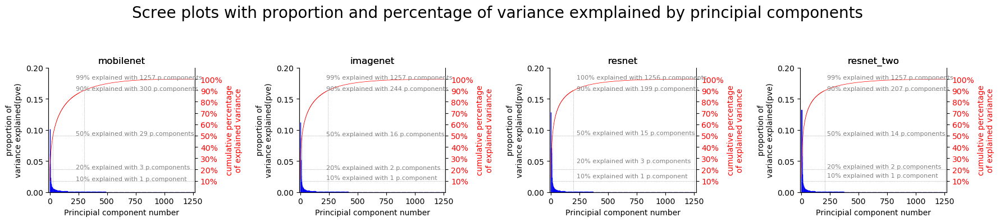

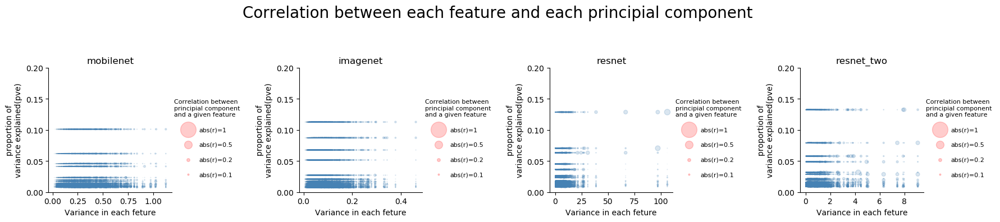

In [5]:
pca_models_dict = pca_analyis_with_plots(
    path=PATH,
    verbose=False,
    dataset_name=dataset_name,
    module_names=module_names,
    subset_names=subset_names,
    class_colors=class_colors,
    scale_data=False
)